In [22]:
import math
import random
import numpy as np
import pandas as pd
from pylab import plt, mpl
plt.style.use('seaborn-v0_8')
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['savefig.dpi'] = 300
mpl.rcParams['font.family'] = 'serif'
np.set_printoptions(suppress=True)

In [ ]:
import random
import numpy as np
import pandas as pd

class ActionSpace:
    def sample(self):
        return random.randint(0, 1)

class Finance:
    url = 'https://certificate.tpq.io/rl4finance.csv'
    
    def __init__(self, symbol, feature, min_accuracy=0.485, n_features=4):
        self.symbol = symbol
        self.feature = feature
        self.n_features = n_features
        self.action_space = ActionSpace()
        self.min_accuracy = min_accuracy
        self._get_data()
        self._prepare_data()
    
    def _get_data(self):
        self.raw = pd.read_csv(
            self.url,
            index_col=0,
            parse_dates=True
        )
    
    def _prepare_data(self):
        self.data = pd.DataFrame(self.raw[self.symbol]).dropna()
        self.data['r'] = np.log(self.data / self.data.shift(1))
        self.data['d'] = np.where(self.data['r'] > 0, 1, 0)
        self.data.dropna(inplace=True)
        self.data_ = (self.data - self.data.mean()) / self.data.std()
    
    def reset(self):
        self.bar = self.n_features
        self.treward = 0
        state = self.data_[self.feature].iloc[
            self.bar - self.n_features:self.bar
        ].values
        return state, {}
    
    def step(self, action):
        if action == self.data['d'].iloc[self.bar]:
            correct = True
        else:
            correct = False
        reward = 1 if correct else 0
        self.treward += reward
        self.bar += 1
        self.accuracy = self.treward / (self.bar - self.n_features)
        if self.bar >= len(self.data):
            done = True
        elif reward == 1:
            done = False
        elif (self.accuracy < self.min_accuracy) and (self.bar > 15):
            done = True
        else:
            done = False
        next_state = self.data_[self.feature].iloc[
            self.bar - self.n_features:self.bar
        ].values
        return next_state, reward, done, False, {}

In [24]:
import os
import random
import warnings
import numpy as np
import tensorflow as tf
from tensorflow import keras
from collections import deque
from keras.layers import Dense, Flatten
from keras.models import Sequential

# Configure warnings and TensorFlow settings
warnings.simplefilter('ignore')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
opt = keras.optimizers.Adam

class DQLAgent:
    def __init__(self, symbol, feature, n_features, env, hu=24, lr=0.001):
        self.epsilon = 1.0
        self.epsilon_decay = 0.9975
        self.epsilon_min = 0.1
        self.memory = deque(maxlen=2000)
        self.batch_size = 32
        self.gamma = 0.5
        self.trewards = list()
        self.max_treward = -np.inf
        self.n_features = n_features
        self.env = env
        self.episodes = 0
        self._create_model(hu, lr)

    def _create_model(self, hu, lr):
        self.model = Sequential()
        self.model.add(Dense(hu, activation='relu', input_dim=self.n_features))
        self.model.add(Dense(hu, activation='relu'))
        self.model.add(Dense(2, activation='linear'))
        self.model.compile(loss='mse', optimizer=opt(learning_rate=lr))

    def _reshape(self, state):
        state = state.flatten()
        return np.reshape(state, [1, len(state)])

    def act(self, state):
        if random.random() < self.epsilon:
            return self.env.action_space.sample()
        return np.argmax(self.model.predict(state)[0])

    def replay(self):
        batch = random.sample(self.memory, self.batch_size)
        for state, action, next_state, reward, done in batch:
            if not done:
                reward += self.gamma * np.amax(self.model.predict(next_state)[0])
            target = self.model.predict(state)
            target[0, action] = reward
            self.model.fit(state, target, epochs=1, verbose=False)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

    def learn(self, episodes):
        for e in range(1, episodes + 1):
            self.episodes += 1
            state, _ = self.env.reset()
            state = self._reshape(state)
            treward = 0
            
            for f in range(1, 5000):
                self.f = f
                action = self.act(state)
                next_state, reward, done, trunc, _ = self.env.step(action)
                treward += reward
                next_state = self._reshape(next_state)
                self.memory.append([state, action, next_state, reward, done])
                state = next_state
                
                if done:
                    self.trewards.append(treward)
                    self.max_treward = max(self.max_treward, treward)
                    templ = f'episode={self.episodes:4d} | '
                    templ += f'treward={treward:7.3f}'
                    templ += f' | max={self.max_treward:7.3f}'
                    print(templ, end='\r')
                    break
                    
            if len(self.memory) > self.batch_size:
                self.replay()
        print()

    def test(self, episodes, min_accuracy=0.0, min_performance=0.0, 
             verbose=True, full=True):
        ma = self.env.min_accuracy
        self.env.min_accuracy = min_accuracy
        
        if hasattr(self.env, 'min_performance'):
            mp = self.env.min_performance
            self.env.min_performance = min_performance
            
        self.performances = list()
        
        for e in range(1, episodes + 1):
            state, _ = self.env.reset()
            state = self._reshape(state)
            
            for f in range(1, 5001):
                action = np.argmax(self.model.predict(state)[0])
                state, reward, done, trunc, _ = self.env.step(action)
                state = self._reshape(state)
                
                if done:
                    templ = f'total reward={f:4d} | '
                    templ += f'accuracy={self.env.accuracy:.3f}'
                    
                    if hasattr(self.env, 'min_performance'):
                        self.performances.append(self.env.performance)
                        templ += f' | performance={self.env.performance:.3f}'
                        
                    if verbose:
                        if full:
                            print(templ)
                        else:
                            print(templ, end='\r')
                    break
                    
        self.env.min_accuracy = ma
        if hasattr(self.env, 'min_performance'):
            self.env.min_performance = mp
        print()

In [25]:
import math
import random
import numpy as np
import pandas as pd
from numpy.random import default_rng

rng = default_rng()

class ActionSpace:
    def sample(self):
        return random.randint(0, 1)

class Simulation:
    def __init__(self, symbol, feature, n_features,
                 start, end, periods,
                 min_accuracy=0.525, x0=100,
                 kappa=1, theta=100, sigma=0.2,
                 normalize=True, new=False):
        self.symbol = symbol
        self.feature = feature
        self.n_features = n_features
        self.start = start
        self.end = end
        self.periods = periods
        self.x0 = x0
        self.kappa = kappa
        self.theta = theta
        self.sigma = sigma
        self.min_accuracy = min_accuracy
        self.normalize = normalize
        self.new = new
        self.action_space = ActionSpace()
        self._simulate_data()
        self._prepare_data()

    def _simulate_data(self):
        index = pd.date_range(
            start=self.start,
            end=self.end,
            periods=self.periods
        )
        s = [self.x0]
        dt = (index[-1] - index[0]).days / 365 / self.periods
        
        for t in range(1, len(index)):
            s_ = (s[t - 1] + 
                 self.kappa * (self.theta - s[t - 1]) * dt +
                 s[t - 1] * self.sigma * math.sqrt(dt) * random.gauss(0, 1))
            s.append(s_)

        self.data = pd.DataFrame(s, columns=[self.symbol], index=index)

    def _prepare_data(self):
        self.data['r'] = np.log(self.data / self.data.shift(1))
        self.data.dropna(inplace=True)
        
        if self.normalize:
            self.mu = self.data.mean()
            self.std = self.data.std()
            self.data_ = (self.data - self.mu) / self.std
        else:
            self.data_ = self.data.copy()
            
        self.data['d'] = np.where(self.data['r'] > 0, 1, 0)
        self.data['d'] = self.data['d'].astype(int)

    def _get_state(self):
        return self.data_[self.feature].iloc[
            self.bar - self.n_features:self.bar
        ]

    def seed(self, seed):
        random.seed(seed)
        np.random.seed(seed)
        tf.random.set_random_seed(seed)

    def reset(self):
        if self.new:
            self._simulate_data()
            self._prepare_data()
        self.treward = 0
        self.accuracy = 0
        self.bar = self.n_features
        state = self._get_state()
        return state.values, {}

    def step(self, action):
        if action == self.data['d'].iloc[self.bar]:
            correct = True
        else:
            correct = False
            
        reward = 1 if correct else 0
        self.treward += reward
        self.bar += 1
        self.accuracy = self.treward / (self.bar - self.n_features)
        
        if self.bar >= len(self.data):
            done = True
        elif reward == 1:
            done = False
        elif (self.accuracy < self.min_accuracy and
              self.bar > self.n_features + 15):
            done = True
        else:
            done = False
            
        next_state = self.data_[self.feature].iloc[
            self.bar - self.n_features:self.bar
        ].values
        return next_state, reward, done, False, {}

<Axes: title={'center': 'GLD'}, xlabel='Date'>

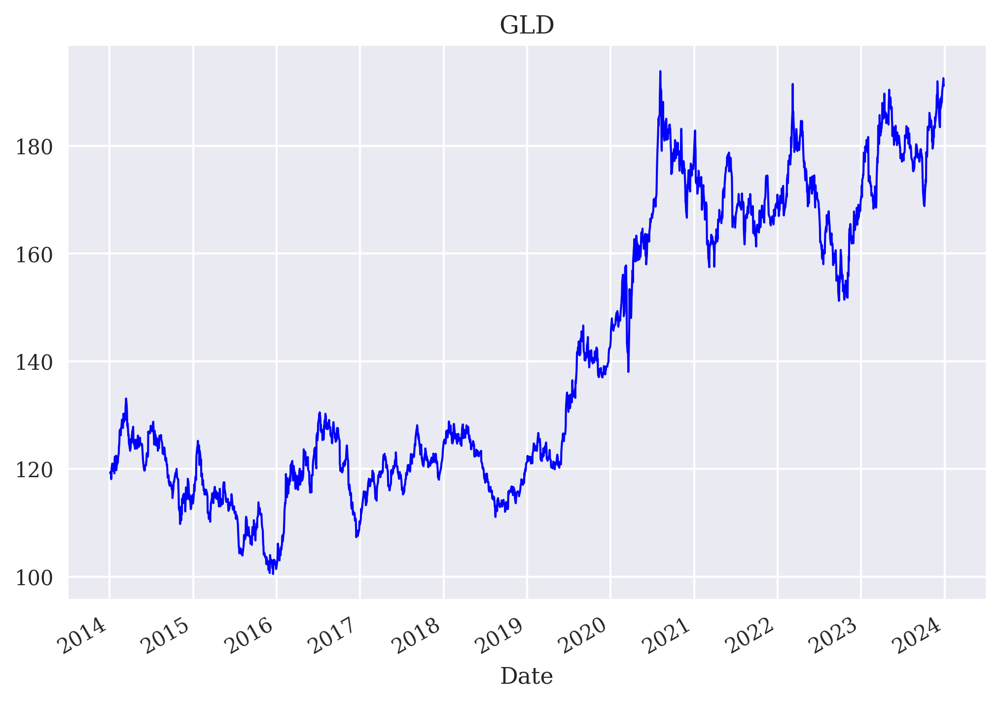

In [26]:
finance = Finance('GLD', 'r', min_accuracy=47.5, n_features=8)

finance.data[finance.symbol].plot(
    title=finance.symbol,
    lw=1.0,
    c='b'
)

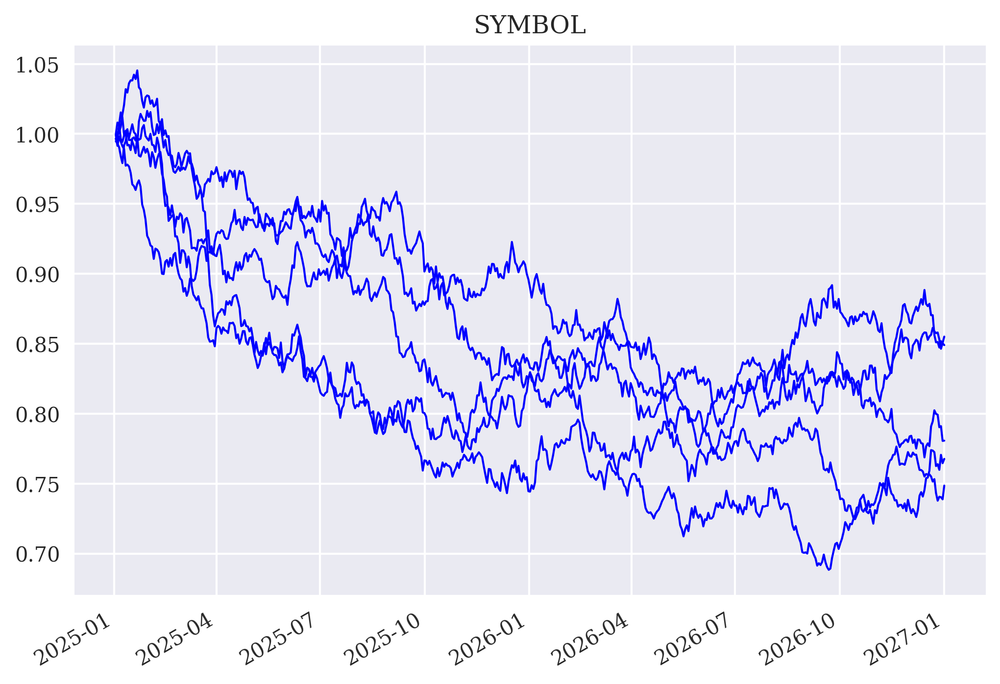

In [27]:
random.seed(500)
simulation = Simulation('SYMBOL', 'r', 4, '2025-1-1', '2027-1-1', 2 * 252, min_accuracy=0.5, x0=1, kappa=1, theta=0.75, sigma=0.1, new=True, normalize=True)
for _ in range(5):
    simulation.reset()
    simulation.data[simulation.symbol].plot(title=simulation.symbol,
    lw=1.0, c='b')

In [28]:
# Set random seeds for reproducibility
random.seed(100)
tf.random.set_seed(100)

In [29]:
dqlagent = DQLAgent(
    finance.symbol,
    finance.feature,
    finance.n_features,
    finance,
    lr=0.0001
)

In [30]:
%time dqlagent.learn(500)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━

In [31]:
dqlagent.test(3)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━

In [32]:
class ActionSpace:
    def sample(self):
        return random.randint(0, 1)

class Trading:
    def __init__(self, symbol, features, window, lags,
        start, end, periods,
        x0=100, kappa=1, theta=100, sigma=0.2,
        leverage=1, min_accuracy=0.5, min_performance=0.85,
        mu=None, std=None,
        new=True, normalize=True):
        self.symbol = symbol
        self.features = features
        self.n_features = len(features)
        self.window = window
        self.lags = lags
        self.start = start
        self.end = end
        self.periods = periods
        self.x0 = x0
        self.kappa = kappa
        self.theta = theta
        self.sigma = sigma
        self.leverage = leverage
        self.min_accuracy = min_accuracy
        self.min_performance = min_performance
        self.start = start
        self.end = end
        self.mu = mu
        self.std = std
        self.new = new
        self.normalize = normalize
        self.action_space = ActionSpace()
        self._simulate_data()
        self._prepare_data()

class Trading(Trading):
    def _simulate_data(self):
        index = pd.date_range(start=self.start,
            end=self.end, periods=self.periods)
        s = [self.x0]
        dt = (index[-1] - index[0]).days / 365 / self.periods
        for t in range(1, len(index)):
            s_ = (s[t - 1] + self.kappa * (self.theta - s[t - 1]) * dt
            + s[t - 1] * self.sigma * math.sqrt(dt) *
            random.gauss(0, 1))
            s.append(s_)
        self.data = pd.DataFrame(s, columns=[self.symbol], index=index)

class Trading(Trading):
    def _prepare_data(self):
        self.data['r'] = np.log(self.data / self.data.shift(1))
        self.data.dropna(inplace=True)
        # additional features
        if self.window > 0:
            self.data['SMA'] = self.data[
            self.symbol].rolling(self.window).mean()
            self.data['DEL'] = self.data[
            self.symbol] - self.data['SMA']
            self.data['MIN'] = self.data[
            self.symbol].rolling(self.window).min()
            self.data['MAX'] = self.data[
            self.symbol].rolling(self.window).max()
            self.data['MOM'] = self.data['r'].rolling(
            self.window).mean()
            # add more features here
            self.data.dropna(inplace=True)
        if self.normalize:
            if self.mu is None or self.std is None:
                self.mu = self.data.mean()
                self.std = self.data.std()
            self.data_ = (self.data - self.mu) / self.std
        else:
            self.data_ = self.data.copy()
        self.data['d'] = np.where(self.data['r'] > 0, 1, 0)
        self.data['d'] = self.data['d'].astype(int)

class Trading(Trading):
    def _get_state(self):
        return self.data_[self.features].iloc[self.bar -
        self.lags:self.bar]
    def seed(self, seed):
        random.seed(seed)
        np.random.seed(seed)
        tf.random.set_random_seed(seed)
    def reset(self):
        if self.new:
            self._simulate_data()
            self._prepare_data()
        self.treward = 0
        self.accuracy = 0
        self.actions = list()
        self.returns = list()
        self.performance = 1
        self.bar = self.lags
        state = self._get_state()
        return state.values, {}
    
class Trading(Trading):
    def step(self, action):
        correct = action == self.data['d'].iloc[self.bar]
        ret = self.data['r'].iloc[self.bar] * self.leverage
        reward_ = 1 if correct else 0
        pl = abs(ret) if correct else -abs(ret)
        reward = reward_
        # alternative options:
        # reward = pl # only the P&L in log returns
        # reward = reward_ + 10 * pl # the reward + the scaled P&L
        self.treward += reward
        self.bar += 1
        self.accuracy = self.treward / (self.bar - self.lags)
        self.performance *= math.exp(pl)
        if self.bar >= len(self.data):
            done = True
        elif reward_ == 1:
            done = False
        elif (self.accuracy < self.min_accuracy and
        self.bar > self.lags + 15):
            done = True
        elif (self.performance < self.min_performance and
        self.bar > self.lags + 15):
            done = True
        else:
            done = False
        state = self._get_state()
        return state.values, reward, done, False, {}

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 494 entries, 2024-01-15 12:47:14.194831014 to 2026-01-01 00:00:00
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   SYMBOL  494 non-null    float64
 1   r       494 non-null    float64
 2   SMA     494 non-null    float64
 3   DEL     494 non-null    float64
 4   MIN     494 non-null    float64
 5   MAX     494 non-null    float64
 6   MOM     494 non-null    float64
 7   d       494 non-null    int32  
dtypes: float64(7), int32(1)
memory usage: 32.8 KB


<Axes: >

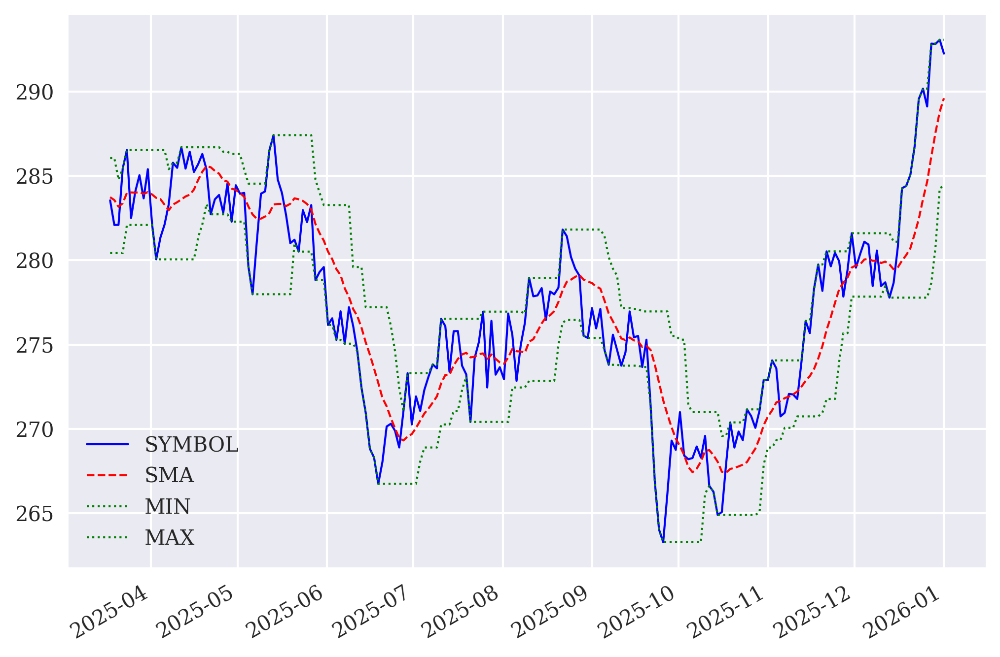

In [33]:
symbol = 'SYMBOL'
trading = Trading(symbol, [symbol, 'r', 'DEL'], window=10, lags=5,
    start='2024-1-1', end='2026-1-1', periods=504,
    x0=100, kappa=2, theta=300, sigma=0.1, normalize=False)
random.seed(750)
trading.reset()
trading.data.info()
trading.data.iloc[-200:][
    [trading.symbol, 'SMA', 'MIN', 'MAX']].plot(
    style=['b-', 'r--', 'g:', 'g:'], lw=1.0)

In [34]:
class TradingAgent(DQLAgent):
    def _create_model(self, hu, lr):
        self.model = Sequential()
        self.model.add(Dense(hu, input_dim=
        self.env.lags * self.env.n_features,
        activation='relu'))
        self.model.add(Flatten())
        self.model.add(Dense(hu, activation='relu'))
        self.model.add(Dense(2, activation='linear'))
        self.model.compile(loss='mse',
        optimizer=opt(learning_rate=lr))

In [35]:
random.seed(100)
tf.random.set_seed(100)
trading = Trading(symbol, ['r', 'DEL', 'MOM'], window=10, lags=8,
    start='2024-1-1', end='2026-1-1', periods=2 * 252,
    x0=100, kappa=2, theta=50, sigma=0.1,
    leverage=1, min_accuracy=0.5, min_performance=0.85,
    new=True, normalize=True)
tradingagent = TradingAgent(trading.symbol, trading.features, trading.n_features, trading, hu=24, lr=0.0001)

In [38]:
%time tradingagent.test(100, min_accuracy=0.0, min_performance=0.0, verbose=True, full=False)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━

In [39]:
random_performances = tradingagent.performances
print(sum(random_performances) / len(random_performances))

0.7349392873819821


Text(0, 0.5, 'frequency')

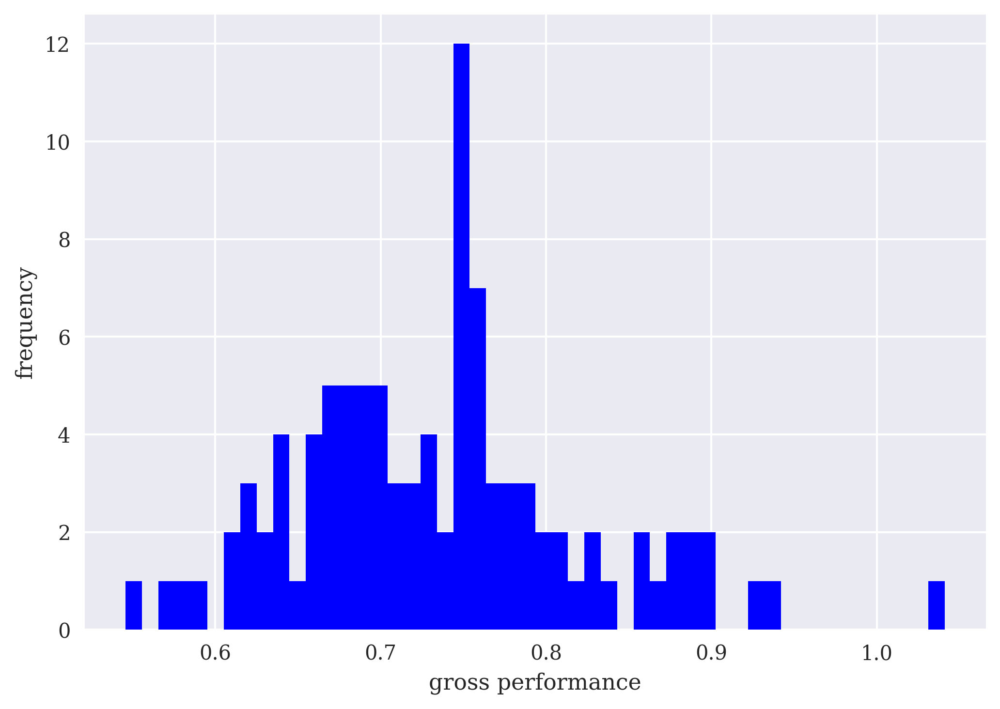

In [40]:
plt.hist(random_performances, bins=50, color='b')
plt.xlabel('gross performance')
plt.ylabel('frequency')

In [ ]:
%time tradingagent.learn(500)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━

In [ ]:
%time tradingagent.test(50, min_accuracy=0.0, min_performance=0.0, verbose=True, full=False)

In [ ]:
sum(tradingagent.performances) / len(tradingagent.performances)

In [ ]:
plt.hist(random_performances, bins=30, color='b', label='random (left)')
plt.hist(tradingagent.performances, bins=30, color='r', label='trained(right)')
plt.xlabel('gross performance')
plt.ylabel('frequency')
plt.legend()